# KaKao Arena - Melon Playlist Continuation Challenge
---
### This repository contains source codes which used for "Final Project for CUAI 5th Winter Conference

### 데이터셋 구성

  - 플레이리스트 메타데이터
  - 플레이리스트 제목
  - 플레이리스트에 수록된 곡
  - 플레이리스트에 달려있는 태그 목록
  - 플레이리스트 좋아요 수
  - 플레이리스트가 최종 수정된 시각
  - 곡 메타데이터
  - 곡 제목
  - 앨범 제목
  - 아티스트명
  - 장르
  - 발매일
  - 곡에 대한 Mel-spectrogram

---
**TaeYun Kim (School of Computer Science & Engineering 🖥️, Chung-Ang Univ.)**

## Train 데이터 살펴보기

In [1]:
import numpy as np
import pandas as pd
import re

In [2]:
train = pd.read_json('train.json', typ = 'frame')
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115071 entries, 0 to 115070
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          115071 non-null  object
 1   id            115071 non-null  int64 
 2   plylst_title  115071 non-null  object
 3   songs         115071 non-null  object
 4   like_cnt      115071 non-null  int64 
 5   updt_date     115071 non-null  object
dtypes: int64(2), object(4)
memory usage: 5.3+ MB


In [3]:
train

,tags,id,plylst_title,songs,like_cnt,updt_date
0,[락],61281,여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954...",71,2013-12-19 18:36:19.000
1,"[추억, 회상]",10532,요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427...",1,2014-12-02 16:19:42.000
2,"[까페, 잔잔한]",76951,"편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598...",17,2017-08-28 07:09:34.000
3,"[연말, 눈오는날, 캐럴, 분위기, 따듯한, 크리스마스캐럴, 겨울노래, 크리스마스,...",147456,크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033...",33,2019-12-05 15:15:18.000
4,[댄스],27616,추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,...",9,2011-10-25 13:54:56.000
...,...,...,...,...,...,...
115066,"[록메탈, 밴드사운드, 록, 락메탈, 메탈, 락, extreme]",120325,METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714...",3,2020-04-17 04:31:11.000
115067,[일렉],106976,빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288...",13,2015-12-24 17:23:19.000
115068,"[담시, 가족, 눈물, 그리움, 주인공, 나의_이야기, 사랑, 친구]",11343,#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943...",4,2019-08-16 20:59:22.000
115069,"[잔잔한, 버스, 퇴근버스, Pop, 풍경, 퇴근길]",131982,퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217...",4,2019-10-25 23:40:42.000


In [4]:
print(train['tags'][0:5])

0                                                  [락]
1                                             [추억, 회상]
2                                            [까페, 잔잔한]
3    [연말, 눈오는날, 캐럴, 분위기, 따듯한, 크리스마스캐럴, 겨울노래, 크리스마스,...
4                                                 [댄스]
Name: tags, dtype: object


## tags에서 숫자, 영어로 된 태그를 제거

In [6]:
# 숫자가 잇으면 0을 리턴
def del_eng_number(string):
    return_str = []
    
    #한글만 남기고 제거
    for s in string:
        
        hangul = re.compile('[^ ㄱ-ㅣ가-힣+]')
        result = hangul.sub('', s) 
        
        # 만약 영어, 숫자가 있으면 0을 return
        # 보통 숫자나 영어를 지우게 되면 문장이 원래 의미를 잃으므로 그냥 삭제
        if(result == ''):
            return 0        
        
        return_str.append(result)
    
    #분리된 list를 합쳐줌
    return_str = ''.join(return_str)
    
    #한글 태그를 return
    return return_str

In [7]:
# 함수 사용 예시
temp_list = 'ㄱㄴㄷ'
print(del_eng_number(temp_list))
temp_list = '123ㄱㄴ'
print(del_eng_number(temp_list))
temp_list = 'abcㄱㄴ'
print(del_eng_number(temp_list))

ㄱㄴㄷ
0
0


### train 데이터 프레임에서 숫자, 영어 제거
- 만약 빈 행이라면 그 행 삭제

In [8]:
# columns을 tag와 playlist를 가지는 df 생성
df = pd.DataFrame(index = range(0),columns = ['tags', 'plylst_title', 'songs'])


for index, row in train.iterrows():
    tags = row["tags"]
    playlist_title = row["plylst_title"]
    korean_tags = []
    for i in range(len(tags)):
        korean_tag = del_eng_number(tags[i])
        
        # return이 0이면 숫자 or 영어가 있던 태그
        if(korean_tag != 0):
            korean_tags.append(korean_tag)
    
    #한글로만 이루어진 tag list : korean_tags
    df.loc[index] = [korean_tags, playlist_title, row["songs"]]
    
    if index % 1000 == 0:
        print(df.info())
        

    
    



<class 'pandas.core.frame.DataFrame'>
Int64Index: 1 entries, 0 to 0
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          1 non-null      object
 1   plylst_title  1 non-null      object
 2   songs         1 non-null      object
dtypes: object(3)
memory usage: 32.0+ bytes
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          1001 non-null   object
 1   plylst_title  1001 non-null   object
 2   songs         1001 non-null   object
dtypes: object(3)
memory usage: 31.3+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2001 entries, 0 to 2000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          2001 non-null   object
 1   plylst_title  2001 non-null   object
 2   

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23001 entries, 0 to 23000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          23001 non-null  object
 1   plylst_title  23001 non-null  object
 2   songs         23001 non-null  object
dtypes: object(3)
memory usage: 718.8+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 24001 entries, 0 to 24000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          24001 non-null  object
 1   plylst_title  24001 non-null  object
 2   songs         24001 non-null  object
dtypes: object(3)
memory usage: 750.0+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 25001 entries, 0 to 25000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          25001 non-null  object
 1   plylst_title  25001 non-null  o

<class 'pandas.core.frame.DataFrame'>
Int64Index: 46001 entries, 0 to 46000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          46001 non-null  object
 1   plylst_title  46001 non-null  object
 2   songs         46001 non-null  object
dtypes: object(3)
memory usage: 1.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 47001 entries, 0 to 47000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          47001 non-null  object
 1   plylst_title  47001 non-null  object
 2   songs         47001 non-null  object
dtypes: object(3)
memory usage: 1.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 48001 entries, 0 to 48000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          48001 non-null  object
 1   plylst_title  48001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69001 entries, 0 to 69000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          69001 non-null  object
 1   plylst_title  69001 non-null  object
 2   songs         69001 non-null  object
dtypes: object(3)
memory usage: 2.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 70001 entries, 0 to 70000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          70001 non-null  object
 1   plylst_title  70001 non-null  object
 2   songs         70001 non-null  object
dtypes: object(3)
memory usage: 2.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 71001 entries, 0 to 71000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          71001 non-null  object
 1   plylst_title  71001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 92001 entries, 0 to 92000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          92001 non-null  object
 1   plylst_title  92001 non-null  object
 2   songs         92001 non-null  object
dtypes: object(3)
memory usage: 2.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 93001 entries, 0 to 93000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          93001 non-null  object
 1   plylst_title  93001 non-null  object
 2   songs         93001 non-null  object
dtypes: object(3)
memory usage: 2.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 94001 entries, 0 to 94000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          94001 non-null  object
 1   plylst_title  94001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115001 entries, 0 to 115000
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          115001 non-null  object
 1   plylst_title  115001 non-null  object
 2   songs         115001 non-null  object
dtypes: object(3)
memory usage: 3.5+ MB
None


In [ ]:
df.info()
df

## Tag 임베딩 및 유사도 검사 모델 만들기
- 결과적으로는 실패
- 태그를 학습시키려 해봤지만 잘 안되었음

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import urllib.request
import numpy as np
from gensim.models.word2vec import Word2Vec
from konlpy.tag import Okt
from gensim.models import Word2Vec
import gensim


In [3]:
df = pd.read_json('pre_data.json', typ = 'frame')

In [4]:
df

,tags,plylst_title,songs
0,[락],여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954..."
1,"[추억, 회상]",요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427..."
2,"[까페, 잔잔한]","편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598..."
3,"[연말, 눈오는날, 캐럴, 분위기, 따듯한, 크리스마스캐럴, 겨울노래, 크리스마스,...",크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033..."
4,[댄스],추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,..."
...,...,...,...
115066,"[록메탈, 밴드사운드, 록, 락메탈, 메탈, 락]",METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714..."
115067,[일렉],빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288..."
115068,"[담시, 가족, 눈물, 그리움, 주인공, 사랑, 친구]",#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943..."
115069,"[잔잔한, 버스, 퇴근버스, 풍경, 퇴근길]",퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217..."


In [7]:
tags = []

for index, row in df.iterrows():
    tags.append(row["tags"])
    
tags =  np.concatenate(tags).tolist()
tags_set = set(tags)
tags_list = list(tags_set)

In [8]:
len(tags_set)


22779

In [9]:
result = tags_list
tags_list.sort()
result

['',
 'ㄱㄷㄹㅍ',
 'ㄹ',
 'ㅁㄴㅇㄹ',
 'ㅋㅋ',
 'ㅎㅎ',
 'ㅠㅠ',
 '가가가가',
 '가게',
 '가게노래',
 '가게에서',
 '가게음악',
 '가게저장용',
 '가고만다',
 '가고싶다',
 '가고싶은그고',
 '가곡',
 '가공식품',
 '가구',
 '가그맨',
 '가꾸자',
 '가끔',
 '가끔발라드도있을껄',
 '가끔은',
 '가끔은필요한',
 '가나다라',
 '가는',
 '가는세월',
 '가는해',
 '가능성',
 '가던길멈추는',
 '가득',
 '가디너',
 '가디언스오브갤럭시',
 '가디언즈',
 '가디언즈오브갤럭시',
 '가디언즈오브더갤럭시',
 '가라앉다',
 '가라앉은',
 '가라오케',
 '가련다',
 '가로등',
 '가로수길',
 '가리온',
 '가만히',
 '가만히있고싶을때',
 '가만히있자',
 '가면',
 '가면라이더',
 '가면라이더제로원',
 '가면라이더지오',
 '가면쓴',
 '가무',
 '가버렸다',
 '가벼운',
 '가벼운노래',
 '가벼운발걸음',
 '가벼운운동',
 '가벼운음악',
 '가벼움',
 '가볍게',
 '가볍게듣기좋은',
 '가볍게듣기좋은노래',
 '가볍게듣는이지리스닝클래식',
 '가볍게들을수있는곡',
 '가볍고',
 '가분좋은',
 '가비엔제이',
 '가뿐',
 '가뿐하게',
 '가사',
 '가사가',
 '가사가공감가는노래',
 '가사가귀여운음악',
 '가사가너무좋은노래',
 '가사가들리는노래',
 '가사가예쁜',
 '가사가예쁜노래',
 '가사가와닿는',
 '가사가이쁜',
 '가사가이쁨',
 '가사가이상한노래',
 '가사가좋다',
 '가사가좋은',
 '가사가좋은노래',
 '가사가좋은음악',
 '가사가흥얼흥얼',
 '가사공감',
 '가사는못알아들어도',
 '가사는장담한다',
 '가사대박',
 '가사로듣는',
 '가사를들려주고싶은노래',
 '가사를읽다',
 '가사보다비트',
 '가사없는',
 '가사없는노래',
 '가사없는연주곡',
 '가사없는음악',
 '가사없음',
 '가사에끌리다',
 '

In [10]:
print('총 샘플의 개수 : {}'.format(len(result)))


총 샘플의 개수 : 22779


In [11]:
stopwords = ['의','가','이','은','들','는','좀','잘','걍','과','도','를','으로','자','에','와','한','하다']

okt = Okt()
tokenized_data = []
for sentence in result:
    temp_X = okt.morphs(sentence, stem=True) # 토큰화
    temp_X = [word for word in temp_X if not word in stopwords] # 불용어 제거
    tokenized_data.append(temp_X)

In [12]:
tokenized_data

[[],
 ['ㄱㄷㄹㅍ'],
 ['ㄹ'],
 ['ㅁㄴㅇㄹ'],
 ['ㅋㅋ'],
 ['ㅎㅎ'],
 ['ㅠㅠ'],
 ['가가', '가가'],
 ['가게'],
 ['가게', '노래'],
 ['가게', '에서'],
 ['가게', '음악'],
 ['가게', '저', '장용'],
 ['가다', '말다'],
 ['가다'],
 ['가다', '그', '고'],
 ['가곡'],
 ['가공', '식품'],
 ['가구'],
 ['가다', '그', '맨'],
 ['가꾸다'],
 ['가끔'],
 ['가끔', '발라드', '있다', '껄'],
 ['가끔'],
 ['가끔', '필요하다'],
 ['가나다라'],
 ['가다'],
 ['가다', '세월'],
 ['가다'],
 ['가능성'],
 ['가다', '멈추다'],
 ['가득'],
 ['가디', '너'],
 ['가디언스', '오브', '갤럭시'],
 ['가디언즈'],
 ['가디언즈', '오브', '갤럭시'],
 ['가디언즈', '오브', '더', '갤럭시'],
 ['가라앉다'],
 ['가라앉다'],
 ['가라오케'],
 ['가다', '다'],
 ['가로등'],
 ['가로수길'],
 ['가리온'],
 ['가만히'],
 ['가만히', '있다', '때'],
 ['가만히', '있다'],
 ['가면'],
 ['가면라이더'],
 ['가면라이더', '제로원'],
 ['가면라이더', '지오'],
 ['가면', '쓸다'],
 ['가무'],
 ['가버리다'],
 ['가볍다'],
 ['가볍다', '노래'],
 ['가볍다', '발걸음'],
 ['가볍다', '운동'],
 ['가볍다', '음악'],
 ['가볍다', '움'],
 ['가볍다'],
 ['가볍다', '듣기', '좋다'],
 ['가볍다', '듣기', '좋다', '노래'],
 ['가볍다', '듣다', '리스닝', '클래식'],
 ['가볍다', '들다', '곡'],
 ['가볍다'],
 ['가분', '좋다'],
 ['가비엔제이'],
 ['가다', '뿐'],
 ['가뿐하다'],
 ['가사'],
 ['가사'],
 [

태그의 최대 길이 : 10
태그의 평균 길이 : 1.8876157864699943


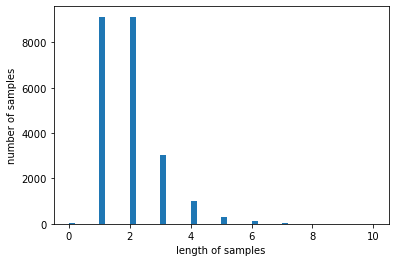

In [13]:
print('태그의 최대 길이 :',max(len(review) for review in tokenized_data))
print('태그의 평균 길이 :',sum(map(len, tokenized_data))/len(tokenized_data))
plt.hist([len(review) for review in tokenized_data], bins=50)
plt.xlabel('length of samples')
plt.ylabel('number of samples')
plt.show()


In [14]:
model_tag = Word2Vec(result, vector_size = 100, window = 1, min_count = 0, workers = 4, sg = 0)


In [15]:
model_tag.wv.vectors.shape

(1389, 100)

In [232]:
model_tag.wv.most_similar("록")

[('빅', 0.9879681468009949),
 ('샘', 0.9876744747161865),
 ('월', 0.987468421459198),
 ('허', 0.9873892068862915),
 ('롬', 0.9872410297393799),
 ('립', 0.987196147441864),
 ('쇼', 0.987034022808075),
 ('체', 0.9869364500045776),
 ('탠', 0.98676997423172),
 ('랄', 0.9866738319396973)]

#### "밴드" 처럼 두 글자를 넣으니 오류가 발생함.

In [233]:
model_tag.wv.most_similar("밴드")

KeyError: "Key '밴드' not present"

## pre trained model 사용
- 모델 출처 : https://fasttext.cc/docs/en/crawl-vectors.html

In [16]:
model = gensim.models.fasttext.load_facebook_model('cc.ko.300.bin.gz')

In [17]:
model.wv.most_similar("록")

[('락', 0.6726381778717041),
 ('호텔라운드', 0.6426533460617065),
 ('錄', 0.624758243560791),
 ('에어즈', 0.5875846147537231),
 ('팝', 0.5718662142753601),
 ('메틀', 0.5676295757293701),
 ('있도', 0.5565808415412903),
 ('록과', 0.5553737282752991),
 ('훵크', 0.5505189299583435),
 ('펑크록', 0.5496084690093994)]

In [18]:
model.wv.similarity("록", "락")

0.6726381

## 태그 유사도 테스트

In [19]:
tags = []

for index, row in df.iterrows():
    tags.append(row["tags"])
    
tags =  np.concatenate(tags).tolist()
tags_set = set(tags)
tags_list = list(tags_set)
tags_list
len(tags_list)

22779

In [21]:
# 예시 
tag_list = []

compare_acc = 0.6

for tag_compare in tags:
    acc = model.wv.similarity(tag_compare, "락")
    if acc > compare_acc:
        tag_list.append(tag_compare)

In [22]:
set(tag_list)

{'락', '록'}

In [26]:
tag_list = []
tag_dic = {}

#유사도 기준값
#0.6 정도 (한국, 중국) (락, 록)이 0.6정도의 서로 정확도를 가짐
compare_acc = 0.6
index = 0

#tags 전체를 다 하고싶으면 0:100 삭제
for tag in tags_list:
    tag_imbeding = []
    for compare_by_tag in tags_list:
        #유사도 비교
        acc = model.wv.similarity(compare_by_tag, tag)
        #print(tag, compare_by_tag, acc)
    
        #compare_acc 이상의 유사도이면 유사 tag라 판별
        if acc > compare_acc:
            #print(compare_by_tag)
            tag_imbeding.append(compare_by_tag)    
            
    
    #중복 제거
    tag_imbeding_set = set(tag_imbeding)
    tag_imbeding_list = list(tag_imbeding_set)
        
    #
    tag_dic[tag] = tag_imbeding_list
    
    #태그가 추가되는지 확인하려면 index변수를 통해서 결과 출력
    index = index + 1
    if index % 100 == 0:
        print(index)
        print(len(tag_dic))
        print(tag_dic[tag])

100
100
['현대사회']
200
200
['꿈']
300
300
['이승철']
400
400
['몽환적인환', '새해팝송', '세대초월', '종이의집', '음색여신', '알리시아데라로차', '엄마잠깐만요부른멋쟁이맞아요', '엔니오모리꼬네', '내마음을달래줄음악', '여유롭게듣기좋은음악', '영향받은음악들', '아코디언추억회상', '스베틀린루세브', '시원하고따뜻한음악', '깊은밤에깊', '그대가분다', '수록곡포함', '집중절대못함', '듣기좋은팝송', '이수를모른다는게말이돼', '상큼하게시작해서밤에어울리게', '편안한이지리스닝클래식', '이별후들으면더슬픈노래', '잭브라운밴드', '산다라박머리로가요계를씹어먹어', '문학같은노래제목', '로키호러픽쳐쇼', '은근신나는', '커티스메이필드', '추운계절에듣기좋은노래', '눈감고듣는노래', '남자들의우상', '신나고느낌있는', '알라딘더빙', '게임할때듣기좋은노래', '감성힙합성', '나는몹시움직이고싶다', '포스트말론', '오비클레인', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '마음이촉촉해지는노래', '틀림없이행복해질거예요', '감성인디', '뉴이스트전곡정주행', '클래식명곡', '요즘에듣기좋은노래', '같이듣기좋은노래', '알리고싶은팝가수', '집에서혼자듣는', '새벽에듣는노래', '심지어노래도다좋다', '헤어짐을바라보는', '부승관최한솔이찬', '루싸이트토끼', '침대위에서듣는음악', '인디키키', '바다위의언덕', '사랑이있으면이별도있는법', '여유롭게듣기좋은', '첼로협주곡로맨틱클래식', '권보아', '태그매장음악', '감각적인노래', '비킹구르올라프손', '분위기있는어쿠스틱', '로맨틱멜로디초비', '우리아이태교자장가클래식', '대니쉬걸', '따뜻한연말되세요', '댄스명곡', '소울트리', '크리스마때듣기좋은노래', '술을노래하다', '어느밝은날의', '산책과드라이브할때듣기좋은', '네사촌', '추울때듣는음악', '히사이시조', '산책할때듣기좋은', '호에에엥', '오늘뭐듣지', '듣는노래'

1200
1200
['핑클의']
1300
1300
['김경인']
1400
1400
['하루']
1500
1500
['눈오는날']
1600
1600
['스트레스야날아가라', '나만알고싶은가수', '날녹여주오', '세대초월', '알리시아데라로차', '스트레스해소힐링추천인기클래식', '엄마잠깐만요부른멋쟁이맞아요', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '분위기좋은재즈', '엔니오모리꼬네', '내마음을달래줄음악', '듣는사람마음대로', '천상의목소리', '여유롭게듣기좋은음악', '클라리넷클래식', '아코디언추억회상', '드라마연주곡', '세종솔로이스트', '그대가분다', '집중절대못함', '듣기좋은팝송', '스트레스해소힐링인기첼로클래식', '이수를모른다는게말이돼', '상큼하게시작해서밤에어울리게', '자기전에듣는노래', '이별후들으면더슬픈노래', '산다라박머리로가요계를씹어먹어', '로키호러픽쳐쇼', '찾았다오마이걸', '추운계절에듣기좋은노래', '스매싱펌킨스', '가슴아픈이별노래', '남자들의우상', '글로리아벨', '게임할때듣기좋은노래', '스테이라운지', '트롯여신', '나는몹시움직이고싶다', '오비클레인', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '마음이촉촉해지는노래', '최승철윤정한홍지수', '걸그룹히트곡', '듣고있으면기분좋아지는곡', '틀림없이행복해질거예요', '뉴이스트전곡정주행', '좋은배경음악', '멜로우재즈', '요즘에듣기좋은노래', '같이듣기좋은노래', '새벽에듣는노래', '불면증에좋은음악', '매장에서트는신나는노래', '심지어노래도다좋다', '힙합을좋아하는여자', '헤어짐을바라보는', '밤에듣기좋은노래', '부승관최한솔이찬', '루싸이트토끼', '사랑이있으면이별도있는법', '여유롭게듣기좋은', '애니피아노', '더욱풍성한하루', '태그매장음악', '비킹구르올라프손', '분위기있는어쿠스틱', '우리아이태교자장가클래식', '대니쉬걸', '트로트천만인증', '댄스명곡', '레전드의귀환', '새박감성', '크리스마때듣기좋은노래', '새벽

1700
1700
['검은밤']
1800
1800
[]
1900
1900
['요염']
2000
2000
['바람핀남친']
2100
2100
['인디']
2200
2200
['엄빠', '알딸딸']
2300
2300
['아일랜드']
2400
2400
['리메이크원곡', '리메이크곡모음', '취하고듣기좋은노래', '리메이크명곡', '리메이크가요', '리메이크송']
2500
2500
['집중하기']
2600
2600
['노래방추천', '나만알고싶은가수', '알리시아데라로차', '엄마잠깐만요부른멋쟁이맞아요', '마음이싱숭생숭할때', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '엔니오모리꼬네', '나혼자들을플레이리스트입니다후', '샤워할때듣는음악', '모든따뜻한피아노', '천상의목소리', '여유롭게듣기좋은음악', '울지말고치킨', '스베틀린루세브', '콘셉트평가곡', '밤의시티팝', '감수성폭발', '일할때듣는음악', '스트레스해소힐링인기첼로클래식', '상큼하게시작해서밤에어울리게', '이별후들으면더슬픈노래', '존윌리엄스', '산다라박머리로가요계를씹어먹어', '마음이편안해지는클래식', '커티스메이필드', '깨는트로트', '산뜻한게필요할때', '알라딘더빙', '나는몹시움직이고싶다', '내가있잖아요', '락발라드전설', '브리티시인베이전', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '마음이촉촉해지는노래', '듣고있으면기분좋아지는곡', '이별후에듣는노래', '뉴이스트전곡정주행', '뒹굴뒹굴하며듣기좋은', '푸른밤종현입니다', '요즘에듣기좋은노래', '같이듣기좋은노래', '옐로우몬스터즈', '멜로딕데스메탈', '언택트라이브', '새벽에듣는노래', '외국펍에서나올듯한', '브랜뉴콘', '에릭머큐리', '심지어노래도다좋다', '미스터션샤인', '헤어짐을바라보는', '힙합을좋아하는여자', '퇴사러의꿈', '음악선물세트', '소녀시대콘서트', '여유롭게듣기좋은', '디바인채널', '더욱풍성한하루', '엘레지의여왕', '뉴에이지클래식', '친숙한작곡가클래식', '시대를앞서간

2700
2700
['허비행콕', '소녀시대노래추천', '연인과듣고싶은노래', '비올때듣는음악', '비올때듣기좋은노래', '안준성한보람고남수정병균김보아', '음색좋은여자보컬', '그작업말고일']
2800
2800
['스토브']
2900
2900
['사이타마']
3000
3000
['짠내투어']
3100
3100
['옛추억']
3200
3200
['빅히트']
3300
3300
['세대초월', '일본밴드', '마음이싱숭생숭할때', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '여유롭게듣기좋은음악', '스쿨보이큐', '휴식시간에듣는힐링클래식', '돼지띠뮤지션', '아코디언추억회상', '고요한시간', '세종솔로이스트', '밤에듣기좋은곡', '사랑노래가아닌노래', '남자이돌', '연애시작', '강아지안정음악', '상큼하게시작해서밤에어울리게', '안너빌스마', '여기가천국', '기분전환하기좋은', '클로버자장가들어줘', '엉덩이가들썩들썩', '조지클린턴', '힘이나는노래', '존윌리엄스', '업리프팅클래식', '아이작헤이즈', '웬디스타채팅', '걸그룹인생곡', '스매싱펌킨스', '키키키', '졸음운전은없다', '귀르가즘뉴에이지', '어깨들썩이는비트', '좋은음악만들기', '듣다보면빠져들걸', '브리티시인베이전', '갓띵곡모음', '카페에앉아듣기좋은음악', '듣고있으면기분좋아지는곡', '감성증폭제', '가슴따뜻한가수', '공부할때듣는음악', '같이듣기좋은노래', '썸머드라이브', '피아노가좋은재즈', '이제서야너에게', '수록곡위주', '불면증에좋은음악', '매장에서트는신나는노래', '심지어노래도다좋다', '힙합을좋아하는여자', '루싸이트토끼', '로맨틱크리스마스', '인디키키', '창작용', '바다위의언덕', '삭제삭제삭제', '로맨틱멜로디초비', '우리아이태교자장가클래식', '세바스티앙텔레이르', '트로트의여왕', '반려견과함께듣는클래식', '새박감성', '신나게듣는곡', '새벽감성오짐', '술을노래하다', '소란데이', '커피숖매장호텔로비추천클래식', '산책과

3400
3400
['알리시아데라로차', '엄마잠깐만요부른멋쟁이맞아요', '공부할때듣기좋은', '천상의목소리', '모든따뜻한피아노', '여유롭게듣기좋은음악', '스트레스해소힐링인기첼로클래식', '상큼하게시작해서밤에어울리게', '자기전에듣는노래', '산다라박머리로가요계를씹어먹어', '마음이편안해지는클래식', '가을에어울리는', '착한생각', '커티스메이필드', '남자들의우상', '비내리는오후', '귀르가즘뉴에이지', '게임할때듣기좋은노래', '나는몹시움직이고싶다', '락발라드전설', '브리티시인베이전', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '이별후에듣는노래', '뉴이스트전곡정주행', '같이듣기좋은노래', '알리고싶은팝가수', '멜로딕데스메탈', '새벽에듣는노래', '브랜뉴콘', '헤어짐을바라보는', '퇴사러의꿈', '침대위에서듣는음악', '소녀시대콘서트', '사랑이있으면이별도있는법', '여유롭게듣기좋은', '디바인채널', '더욱풍성한하루', '삭제삭제삭제', '감각적인노래', '앨범이미지', '분위기있는어쿠스틱', '금관앙상블', '대니쉬걸', '따뜻한연말되세요', '끈적한그루브', '트로트의여왕', '새박감성', '크리스마때듣기좋은노래', '술을노래하다', '산책과드라이브할때듣기좋은', '감각적인음악', '팝송추천팝송', '변신할땐공격하지않는다', '산책할때듣기좋은', '한국힙합에볼루션', '마음이편안해지는멜로디', '태연의아주특별한하루', '예쁘게봐주세욥', '사랑하는주님', '사랑의콜센타', '해쉬브라운이아니야해쉬스완이야', '재즈가흐르는카페', '일할때듣기좋은노래', '우리아기자장가', '이별후에혼자듣기좋은노래', '이매진드래곤스', '이달의소녀오드아이써클', '사랑하는사람과함께', '상처입은사람에게추천음악', '엄청긴태그도있어요오오오발라드', '혼자듣기좋은', '달릴때듣는', '매력있는노래', '뉴에이지힐링', '기분좋은음악', '언제나빛나는우주최강아이돌', '점점빠져드는', '잘때듣기좋은', '마음을달래주는', '돌아와요부산항에', '쓸모있

5100
5100
['활동']
5200
5200
['잔잔한위로']
5300
5300
['찬양']
5400
5400
['느낌옴', '한국뮤지션이만든월드뮤직', '썸남썸녀에게들려주면있어보임']
5500
5500
['당당함']
5600
5600
['위저']
5700
5700
['도치맘', '존좋', '달달해', '아프지마', '헿', '냠', '헬요일', '눙물', '시험끝', '집콕', '꽃길만걷자', '맴찢', '우리아들', '잠이안와', '엄빠', '우리딸', '으앙', '씐나']
5800
5800
['천상의목소리', '여유롭게듣기좋은음악', '형돈이와대준이', '그루브한노래', '연애하고싶을때', '로맨스는별책부록', '어반뮤직페스티벌', '스테이지메이커스', '짝사랑포기할때듣는음악', '지산밸리록페스티벌', '호텔로비커피샵매장인기클래식', '밤의시티팝', '카페커피숖호텔라운지에서듣는재즈', '필스너우르켈페스티벌', '그린데이셋리스트', '하이네켄스타디움', '랩비트페스티벌', '슬픈노래추천', '파크뮤직페스티벌', '집중절대못함', '새벽감성충만', '달나라여행', '당신의이름을지어며칠은먹었다', '분당파크콘서트', '폼나는노래', '상큼하게시작해서밤에어울리게', '느낌있는음악', '아이돌의숨은명곡돌', '소울쿼리안스', '기분전환하기좋은', '달을건너오는자기에게', '아플때들으면더아픈노래', '무념무우우우우우우우웅유상', '이별후들으면더슬픈노래', '인기휴식힐링스트레스태교클래식', '스펙트럼댄스뮤직페스티벌', '잘생긴클래식아티스트', '저녁에듣기좋은노래', '무더위날려줄시원한곡들', '이불속은싫어', '오늘밤로맨스극장에서', '여름페스티벌', '일상에묻어나는인디음악', '유명한피아니스트클래식', '해수욕장페스티벌', '아이돌솔로곡', '게임할때듣기좋은노래', '휴가와휴식시간듣는클래식', '듣기좋은노래모음', '인디뮤직페스티벌', '할리스페스티벌', '여자꼬실때노래', '에드시런셋리스트', '겨울감성들', '기분전환하기좋은곡', '비오는날재즈', '외로울때

6700
6700
['속삭이듯', '귓가에']
6800
6800
['스트레스야날아가라', '천상의목소리', '여유롭게듣기좋은음악', '상큼하게시작해서밤에어울리게', '클로버자장가들어줘', '산다라박머리로가요계를씹어먹어', '로키호러픽쳐쇼', '탱구티비', '귀르가즘뉴에이지', '알라딘더빙', '게임할때듣기좋은노래', '나는몹시움직이고싶다', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '틀림없이행복해질거예요', '듣고있으면기분좋아지는곡', '요즘에듣기좋은노래', '같이듣기좋은노래', '브랜뉴콘', '심지어노래도다좋다', '달팽이관갬성', '부승관최한솔이찬', '루싸이트토끼', '사랑이있으면이별도있는법', '디바인채널', '첼로협주곡로맨틱클래식', '더욱풍성한하루', '비킹구르올라프손', '사실맥락없음그냥내취향모음', '분위기있는어쿠스틱', '우리아이태교자장가클래식', '라운지클럽핫하다', '크리스마때듣기좋은노래', '술을노래하다', '어느밝은날의', '스윙재즈댄스', '으라차차와이키키', '소중한행복감', '집에서듣는음악', '오픈부터마감까지', '찬양추천', '김심야', '듣다보면눈물나는노래', '해쉬브라운이아니야해쉬스완이야', '남자는랩여자는노래', '재즈가흐르는카페', '일할때듣기좋은노래', '이별후에혼자듣기좋은노래', '이달의소녀오드아이써클', '새벽에들으면좋은음악', '엄청긴태그도있어요오오오발라드', '같은곡다른느낌', '함께감상', '그래도노래는들어야지', '들으면가슴이아파지는', '빅대디케인', '짱짱한성대필요', '잠자기전듣기좋은노래', '파운드케익', '영민시뮤직', '적당히신남', '취하고듣기좋은노래', '좋은혼종', '템포빠른뉴에이지', '혼자걸을떄듣기좋은노래', '매장커피숍호텔로비클래식', '첼로피아노플룻추천클래식', '봄노래추천', '더리싸우스', '운동할때듣기좋은노래', '경쾌한음악', '피아노클래식', '욕하고싶지만교양또한지키고싶다', '누워서듣는노래', '겨울에듣기좋은곡', '클럽노래모음', '로맨틱클래식', '헬스장에세듣는빠른노

7400
7400
['숨듣노']
7500
7500
['시집']
7600
7600
['일렉트로니카', '훵크', '유로팝', '누디스코', '팝펑크', '트립합', '신스팝', '드림팝', '슈게이징', '딥하우스', '칠아웃', '팝록', '시부야케이', '팝댄스', '일렉트로하우스', '다운템포', '포스트락']
7700
7700
['카니발']
7800
7800
['파티피플']
7900
7900
['누재즈', '닭치고연주곡', '나만알고싶은가수', '종이의집', '세대초월', '알리시아데라로차', '엄마잠깐만요부른멋쟁이맞아요', '도자캣', '울지말고치킨', '스베틀린루세브', '스테이지메이커스', '깊은밤에깊', '윤도운', '밤의시티팝', '수록곡포함', '감수성폭발', '일할때듣는음악', '방탄진', '걸그룹댄스', '나만알고싶은팝송', '상큼하게시작해서밤에어울리게', '강아지안정음악', '이별후들으면더슬픈노래', '산다라박머리로가요계를씹어먹어', '문학같은노래제목', '나홀로새벽에', '빵댕이', '외쿡음악', '눈감고듣는노래', '신나고느낌있는', '잘놀아', '게임할때듣기좋은노래', '감성힙합성', '나는몹시움직이고싶다', '오비클레인', '포레스텔라', '브리티시인베이전', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '발라드팝송', '아아망했어요', '에이치엔엠매장음악', '뉴이스트전곡정주행', '여성감성보컬', '클래식명곡', '같이듣기좋은노래', '하이플라잉버즈', '댄스그룹발라드곡', '소중한노래들', '가사가너무좋은노래', '심지어노래도다좋다', '루싸이트토끼', '봄타고', '여름아부탁해', '사랑이있으면이별도있는법', '감성캠핑', '분위기있는어쿠스틱', '로맨틱멜로디초비', '대니쉬걸', '드림스테이션리브포나우', '크리스마때듣기좋은노래', '신나게듣는곡', '술을노래하다', '소란데이', '겨울재즈', '트웬티원파일럿츠', '어느밝은날의', '추울때듣는음악', '산책할때듣기좋은', '마음이따뜻해지는노래', '인생별거없음', '태

8300
8300
['광복', '해방']
8400
8400
['베리화이트']
8500
8500
['벚꽃스캔들', '마이데이', '정글라운지', '알리시아데라로차', '삶의반칙선위의점일뿐이야', '감각적인비트', '그리스도기독교합창클래식', '아르튀르그뤼미오', '나카무라유리코', '가디언즈오브더갤럭시', '차분하고감성적인', '그시절우리가좋아했던소녀', '아름답고도아프구나', '텐조와바스코', '꽃보다청춘아프리카', '꿀벌과천둥', '비오는날듣는재즈', '우울할때듣기좋은팝송', '숨어있던좋은노래', '혼자있을때듣기좋은', '이렇게좋은노래가숨겨져있었다니', '사랑이있으면이별도있는법', '아이들의목소리', '레드벨벳전곡', '아드리아나깔까뇨뚜', '스트레스해소힐링인기첼로클래식', '뭘좋아할지몰라서다준비했어요', '취하고듣기좋은노래', '리듬에몸을맡겨야할때', '분위기있는어쿠스틱', '우리아이자장가하프클래식', '대니쉬걸', '우월한기럭지', '혼자있을때듣기좋은노래', '광고클래식', '인기추천피아노클래식', '크리스티나아길레라', '뭘좋아할지몰라서다준비했어', '열정적인사운드', '새벽감성폭발', '재미있는제목도있음', '피터팬컴플렉스', '로드스튜어트', '이달의소녀오드아이써클', '데이비드보위', '코다라인내한', '크리스토퍼내한', '크리스토퍼도일', '흘러간놓아준것들', '그녀앞에선겸손하게행동하시오', '최신인기트롯', '찬바람불때듣기좋은노래', '어덜트컨템포러리', '영화조커', '호러무비', '힙합터부', '힙하고싶은날', '긍정의에너지가넘치는', '호텔로비커피샵매장인기클래식']
8600
8600
['종이의집', '세대초월', '트리플히트', '일본밴드', '마음이싱숭생숭할때', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '레드제플린보컬', '여유롭게듣기좋은음악', '아코디언추억회상', '새벽감성벽', '돼지띠뮤지션', '고요한시간', '세종솔로이스트', '당신만을위한노래', '카페띵곡모음', '사랑노래가아닌노래', '연애시작', '강아지안정음악

8700
8700
['현빈']
8800
8800
['여름캐롤']
8900
8900
['심장이터질지도몰라', '이지리스닝추천인기클래식', '난자유야', '매장커피숍호텔로비추천인기클래식', '놀러가서듣기딱좋은', '진짜나를찾아가는과정중', '이중에한곡은맘에들꺼야', '사실맥락없음그냥내취향모음', '그루브한노래', '내가무게를치는건지', '엄청긴태그도있어요오오오발라드', '인기휴식힐링스트레스태교클래식', '봄발라드']
9000
9000
['여친에게']
9100
9100
['비올때듣기좋은', '같이듣기좋은노래', '잠잘때듣기좋은곡', '혼자일때듣기좋은노래', '비올때듣기좋은노래', '아이돌명곡모음', '엄마잠깐만요부른멋쟁이맞아요', '가을맞이추천곡', '언에듀케이티드키드', '언제나빛나는우주최강아이돌', '포스트디스코', '졸음방지노래', '잘때듣기좋은', '나카타야스타카', '운동하면서듣는노래', '슬플때듣기좋은노래', '잠안올때듣는음악', '흐뭇과므훗의사이', '그시절우리가좋아했던소녀', '기타가다한음악', '카페커피숖호텔라운지에서듣는재즈', '소녀시대노래추천', '걸으며듣기좋은', '혼자있을때듣기좋은', '돌아와요부산항에', '매장커피숍호텔라운지추천클래식', '당신의이름을지어며칠은먹었다', '사랑이있으면이별도있는법', '웨딩클래식', '레드벨벳전곡', '최고의작곡가바흐인기클래식', '취하고듣기좋은노래', '가슴이답답할때', '잘때듣기좋은노래', '너희들이힙합을아느냐', '소울쿼리안스', '새벽에듣기좋은노래', '우리아이자장가하프클래식', '무념무우우우우우우우웅유상', '매장커피숖호텔라운지추천클래식', '로맨틱무드', '여름휴가때듣기좋은노래', '흔들수있는', '힘내고싶을때', '인기휴식힐링스트레스태교클래식', '산다라박머리로가요계를씹어먹어', '혼자있을때듣기좋은노래', '일할때듣기좋은노래', '공부할때듣기좋은노래', '이별후에혼자듣기좋은노래', '내몸이왜이러지', '음악일기', '재즈와크리스마스', '로맨틱클래식음악', '술을노래하다', '듣지만말고일어나', '

10400
10400
['여행갈때듣기좋은', '혼자일때듣기좋은노래', '비올때듣기좋은노래', '예쁜책', '블랙세인트', '우리아이태교추천인기클래식', '우리아이태교클래식', '슬플때듣기좋은노래', '혼자있을때듣기좋은', '잘때듣기좋은노래', '인기휴식힐링스트레스태교클래식', '혼자있을때듣기좋은노래', '헬스장에서듣기좋은노래', '댄스명곡', '공부할때듣기좋은노래', '크리스마때듣기좋은노래', '무더위날려줄시원한곡들', '쉴때듣기좋은노래', '나는몹시움직이고싶다', '매장에서듣기좋은노래', '운동할때듣기좋은노래', '턴잇업', '흘러간놓아준것들', '외로울때듣기좋은노래', '틀림없이행복해질거예요', '공부할떄듣기좋은', '지금흐르는건눈물이아니다']
10500
10500
['순서는맘대로어차피순서는', '혼자일때듣기좋은노래', '여유롭게듣기좋은음악', '우울할때들으면좋은음악', '인기추천유명작곡가클래식', '다이애나로스', '하얗게불태웠어', '여유롭게듣기좋은', '웨딩클래식', '들썩들썩기분좋은음악', '산책할때듣기좋은음악', '가사를들려주고싶은노래', '린제이로한', '얼마나쓴거야', '쉴때듣기좋은노래', '매장에서듣기좋은음악', '인생을즐기라', '비트에몸을맡겨봐', '내가좋아하는동양풍가요들추천', '이태원펍', '에드시런셋리스트', '산책할때듣기좋은', '욕하고싶지만교양또한지키고싶다', '긍정의에너지가넘치는']
10600
10600
['새벽공방']
10700
10700
['정연준']
10800
10800
['난해한']
10900
10900
['미세먼지때문에못살겠네', '미세먼지많은날', '미세먼지타파']
11000
11000
['드라이브뮤직', '드라이브갈때', '드라이브노래', '드라이브브', '드라이브할때듣는팝', '드라이브드', '드라이브곡', '드라이브할때신나는노래', '드라이브송', '드라이브하며', '드라이브음악', '드라이브팝', '드라이브용알앤비', '드라이브할때신나는', '힙합드라이브음악', '드라이브할때들으면좋은노래', '드라이브팝송', 

11200
11200
['우울증']
11300
11300
['종이의집', '세대초월', '마음이싱숭생숭할때', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '분위기좋은재즈', '여유롭게듣기좋은음악', '아코디언추억회상', '돼지띠뮤지션', '고요한시간', '절대들어', '세종솔로이스트', '카페띵곡모음', '사랑노래가아닌노래', '남자이돌', '강아지안정음악', '상큼하게시작해서밤에어울리게', '여기가천국', '새벽새벽', '클로버자장가들어줘', '기분전환하기좋은', '어번컨템포러리', '엉덩이가들썩들썩', '업리프팅클래식', '아이작헤이즈', '웬디스타채팅', '걸그룹인생곡', '스매싱펌킨스', '졸음운전은없다', '귀르가즘뉴에이지', '어깨들썩이는비트', '좋은음악만들기', '생각에잠길때', '유성유', '클래시컬록', '듣다보면빠져들걸', '브리티시인베이전', '발라드팝송', '카페에앉아듣기좋은음악', '듣고있으면기분좋아지는곡', '가슴따뜻한가수', '레프트필드', '공부할때듣는음악', '같이듣기좋은노래', '썸머드라이브', '피아노가좋은재즈', '이제서야너에게', '수록곡위주', '디제이의플레이리스트', '불면증에좋은음악', '매장에서트는신나는노래', '심지어노래도다좋다', '힙합을좋아하는여자', '여자가수만', '내노래', '루싸이트토끼', '인디키키', '바다위의언덕', '죽고싶을때', '나만의플레이리스트', '권보아', '삭제삭제삭제', '로맨틱멜로디초비', '우리아이태교자장가클래식', '세바스티앙텔레이르', '트로트의여왕', '반려견과함께듣는클래식', '새박감성', '신나게듣는곡', '새벽감성오짐', '영화알라딘', '태그카페', '술을노래하다', '소란데이', '커피숖매장호텔로비추천클래식', '어느밝은날의', '조구마타조구매', '팝송추천팝송', '아이오아이콘서트', '추울때듣는음악', '에이미그랜트', '히사이시조', '오늘뭐듣지', '소중한행복감', '한국힙합에볼루션', '겨울밤에듣기좋은노래', '가요찬송', '출근길퇴근길', '재즈트

11400
11400
['정국']
11500
11500
['베이스기타']
11600
11600
['털']
11700
11700
['요즘발라드위주', '내전공은힙합', '더위극복', '그루브한노래', '도자캣', '깊은밤에깊', '짝사랑포기할때듣는음악', '시티뮤직', '감수성폭발', '겨울리스트', '마라톤노래', '새벽감성충만', '집중절대못함', '버블검소울', '다른가수', '마음의정화', '베로니카이펙트', '달을건너오는자기에게', '플루트바이올린하프클래식', '이별후들으면더슬픈노래', '인기휴식힐링스트레스태교클래식', '날싸좋음', '외쿡음악', '피아노발라드', '저녁에듣기좋은노래', '자신마음속까지알수있는노래', '신나고느낌있는', '추억회상', '주니어마피아', '춤추게만드는음악', '나를위로하는시간', '나를신나게하는노래', '윤식당보고설레일때', '숨듣명', '오비클레인', '마법비트', '에드시런셋리스트', '연인과함께듣고싶은음악', '여행힙합', '블루스기타', '소소하지만확실한행복', '우울할때들으면좋은음악', '부모님취향', '멜로딕팝송', '에이비식스', '여름아부탁해', '감정은그루브를타고', '첼로협주곡로맨틱클래식', '게임할때들으면좋은음악', '그작업말고일', '내적흥분', '과제할때', '팝알못', '나만못가서우울할때', '영국프랑스인기작곡가클래식', '매장커피숍호텔로비추천클래식', '원곡과함께비교하며듣는클래식', '어느밝은날의', '국힙여자래퍼', '이윤설', '피아노바이올린협주곡관현악클래식', '이태원펍', '힐뒤르그뷔드나도티르', '잘자라자장가인기클래식', '아쿠아그레이', '금동현', '매장커피숍호텔로비추천인기클래식', '올디즈벗구디스', '실내악협주곡피아노클래식', '렛잇스노우', '짐싸떠나게', '비오는날듣기좋은노래', '듣다보면좋은음악', '한주의마무리', '온다리쿠', '이웃에방해가되지않는선에서', '타미워커', '메탈이듣고싶을때', '청량한케이팝', '비오는날생각나는노래', '그래미최우수재즈보컬앨범', '어디서

12400
12400
[]
12500
12500
['어꺠들썩']
12600
12600
['보컬음색']
12700
12700
['무술년']
12800
12800
['외로운기분']
12900
12900
['잠자기전에', '자기전', '자기전에']
13000
13000
['유익종', '투빅', '김용임']
13100
13100
['송민호', '씨잼']
13200
13200
['재즈커버']
13300
13300
['마이데이', '삶의반칙선위의점일뿐이야', '잔잔하게들려오는', '여름이다가온다', '인기추천스트레스치유클래식', '가을이라더귀에꽂히는감성사운드', '무더운날듣기좋은', '점점빠져드는', '진짜나를찾아가는과정중', '읏추읏추', '울지말고치킨', '감성저격', '행복하게만들어주는', '훌쩍떠나고싶을때', '가창력종결자', '좋은건같이듣는것', '이렇게좋은노래가숨겨져있었다니', '혼자들어야하는노래', '늦게와서죄송해요', '시대를앞서간노래', '취하고듣기좋은노래', '다시듣고싶은', '겨울이지나가기전에', '다울고있으니까', '기쁠때듣는음악', '나이먹어간다', '손님왔을때', '뉴욕이가까워집니다', '남녀듀엣곡', '우리아기자장가', '아이유목소리', '마음이편안해지는클래식', '재미있는제목도있음', '마음을감싸주는음악', '나가볼까요', '코브라파스타', '데스파시토', '추억회상명곡발라드감수성억', '서울거리아티스트', '멜론디제이니가뭔데삭제못하게해', '내가있잖아요', '새벽감성팝송', '메리추석보내세요', '락발라드전설', '호텔로비레스토랑클래식', '비오는날찾아듣는음악', '스펜서컨피덴셜', '밤과음악사이', '인기추천스트레스해소힐링클래식', '재즈사랑스럽고느끼한재즈음악', '침대안이어폰', '추운날듣기좋은노래', '듣고만있어도기분이좋아지는', '호텔로비커피샵매장인기클래식', '감성마력']
13400
13400
['브라이브']
13500
13500
['회사에']
13600
13600
['댄스오래들으면졸림', '편안한숙면', '새벽감성충만', '플루트

14200
14200
['포크러브송']
14300
14300
['알리시아데라로차', '여유롭게듣기좋은음악', '그루브한노래', '짝사랑포기할때듣는음악', '마음을움직이는가사들', '카페커피숖호텔라운지에서듣는재즈', '빗소리와함께', '재즈띵곡모음', '저녁에들으면좋은클래식', '상큼하게시작해서밤에어울리게', '플루트바이올린하프클래식', '이별후들으면더슬픈노래', '인기휴식힐링스트레스태교클래식', '산책할때듣기좋은음악', '산다라박머리로가요계를씹어먹어', '목관앙상블', '마음을편안하게해주는음악', '산뜻한게필요할때', '일상과다르고싶을때', '잔잔한재즈와함께', '숨듣명', '마음비우고듣기좋은', '에드시런셋리스트', '외로울때듣기좋은노래', '신나는음악까지', '발레리심슨', '카페매장음악추천잔잔한클래식', '드라이브할때듣기좋은', '너도들었으면좋겠어', '뉴이스트전곡정주행', '펼치져는재즈의향연', '같이듣기좋은노래', '일의시작은여섯시부터', '이것만틀면매장에손님가득', '여행갈때듣기좋은', '가사가이상한노래', '생일축하클래식', '마이데이', '합체하면천상의소리', '미스터타이거', '아이돌겨울노래', '그리스도기독교합창클래식', '조용한팝송', '매장에서듣기좋은신나는노래', '심지어노래도다좋다', '멜로딕팝송', '여자댄스곡', '결혼생일축하기념의날클래식', '루싸이트토끼', '꿀벌과천둥', '우울할때듣기좋은팝송', '감정은그루브를타고', '옹성우노래잘해', '하루마무리', '가을이오면생각나는노래', '휴식시간휴가에들으면좋은클래식', '비킹구르올라프손', '사실맥락없음그냥내취향모음', '우리아이태교자장가클래식', '여름휴가때듣기좋은노래', '혼자있을때듣기좋은노래', '바에서듣는재즈', '광고클래식', '댄스명곡', '무더위를날려보낼클래식', '힘들때들으면힘나는노래', '내적댄스폭발', '팝알못', '크리스마때듣기좋은노래', '술을노래하다', '원곡과함께비교하며듣는클래식', '산책과드라이브할때듣기좋은', '멜론디제이니가뭔데삭제못하게해', '피아노탱고왈

14900
14900
['마음이싱숭생숭할때', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '여유롭게듣기좋은음악', '사랑노래가아닌노래', '연애시작', '상큼하게시작해서밤에어울리게', '여기가천국', '클로버자장가들어줘', '존윌리엄스', '키키키', '귀르가즘뉴에이지', '좋은음악만들기', '방탄소년단추천', '브리티시인베이전', '듣고있으면기분좋아지는곡', '같이듣기좋은노래', '불면증에좋은음악', '매장에서트는신나는노래', '심지어노래도다좋다', '힙합을좋아하는여자', '루싸이트토끼', '바다위의언덕', '삭제삭제삭제', '로맨틱멜로디초비', '우리아이태교자장가클래식', '트로트의여왕', '새벽감성오짐', '술을노래하다', '소란데이', '커피숖매장호텔로비추천클래식', '산책과드라이브할때듣기좋은', '어느밝은날의', '팝송추천팝송', '추울때듣는음악', '히사이시조', '인생별거없음', '오늘뭐듣지', '소중한행복감', '한국힙합에볼루션', '가요찬송', '출근길퇴근길', '재즈트로닉', '태연의아주특별한하루', '예쁘게봐주세욥', '랜던플레이', '플리트우드맥', '타미워커', '유명인기추천클래식', '존헨드릭스', '설레이는노래', '비오는날생각나는노래', '헤어지고부터가', '오픈부터마감까지', '루카스그레이엄', '찬양추천', '듣다보면눈물나는노래', '내마음을대변하는노래', '데니스브레인', '버스에서창밖', '라이프온마스', '박효신추천가요', '목소리깡패', '릴렉스타임', '배드보이사단', '차에서듣는음악', '같은곡다른느낌', '포스트펑크리바이벌', '혼자듣기좋은', '그래도노래는들어야지', '기분좋은음악', '빅대디케인', '잘때듣기좋은', '월클돔', '돌아와요부산항에', '우리아이자장가클래식', '영민시뮤직', '혼자들어야하는노래', '좋은혼종', '운동할때듣는빠른노래', '배드보이레코즈', '멜론에없는건빼고', '피아노소나타인기클래식', '가창수행평가', '첼로피아노플룻추천클래식', '하플버', '연인과함께듣기좋은음악', '

15000
15000
[]
15100
15100
['뉴올', '마이노스']
15200
15200
['비올때듣기좋은', '여행갈때듣기좋은', '잠잘때듣기좋은곡', '혼자일때듣기좋은노래', '무더위날려줄힙한곡들', '비올때듣기좋은노래', '회식에서부르면더작살나지', '종현아덕분에내평생이따뜻해', '천상의목소리', '여유롭게듣기좋은음악', '스트래스해소힐링클래식', '헬스장에세듣는빠른노래', '신날때', '그루브한노래', '아빠가들려주는클래식', '진짜나를찾아가는과정중', '슬플때듣기좋은노래', '무더위에듣는추천인기재즈', '우울할때듣기좋은팝송', '혼자있을때듣기좋은', '러어어어언', '취하고듣기좋은노래', '소프트팝', '잘때듣기좋은노래', '새벽에듣기좋은노래', '김광민피아니스트', '여름휴가때듣기좋은노래', '짐을싸게하는음악들', '산책할때듣기좋은음악', '광고클래식', '혼자있을때듣기좋은노래', '인기추천피아노클래식', '레전드의귀환', '일할때듣기좋은노래', '크리스마때듣기좋은노래', '비투비콘서트셋리스트', '기타치며노래하는', '호텔로비에서들리는클래식', '더리싸우스', '운동할때듣기좋은노래', '블루아이드소울', '흘러간놓아준것들', '인트로만으로사로잡는', '그녀앞에선겸손하게행동하시오', '스트래스', '최신인기트롯', '호텔로비레스토랑클래식', '찬바람불때듣기좋은노래', '우리집배경음악', '새벽에듣기좋은팝송', '힙합터부', '렛잇스노우', '스트래스해소보컬클래식', '호텔로비커피샵매장인기클래식', '분위기팝송']
15300
15300
['데일리팝']
15400
15400
['내적흥분', '어디서나당당하게걷기', '베리고디', '비트가치는건지', '감정은그루브를타고', '새벽감성충만', '모르기엔너무좋은노래', '닙시허슬', '메탈이듣고싶을때', '기분전화', '그루브한노래', '하얗게불태웠어', '에로스라마조띠']
15500
15500
['드럼엔베이스']
15600
15600
['태진미디어']
15700
15700
['웨스턴카잇', '딥한음악

15800
15800
['일본노래']
15900
15900
[]
16000
16000
['좀비영화']
16100
16100
['일본타이틀']
16200
16200
['국힙외힙']
16300
16300
['리믹스']
16400
16400
['멜로디포레스트캠프', '정글라운지', '알리시아데라로차', '공부할때듣기좋은', '여유롭게듣기좋은음악', '형돈이와대준이', '연애하고싶을때', '걸그룹계의군통령', '게임할때들으면집중잘되는음악', '카페커피숖호텔라운지에서듣는재즈', '그린데이셋리스트', '하이네켄스타디움', '당신의이름을지어며칠은먹었다', '슬픈노래추천', '좋아하는가수노래모음', '라이프이즈스트레인지비포더스톰', '스트레스해소힐링인기첼로클래식', '이수를모른다는게말이돼', '상큼하게시작해서밤에어울리게', '가을맞이플레이리스트', '너희들이힙합을아느냐', '달을건너오는자기에게', '아플때들으면더아픈노래', '무념무우우우우우우우웅유상', '연말에우울해지지않기위해', '존윌리엄스', '산책할때듣기좋은음악', '무더위를날려보낼클래식', '산다라박머리로가요계를씹어먹어', '가사를들려주고싶은노래', '새벽감성폭발', '할로윈음악', '적당해서더좋은비트', '어반소울', '오늘의다은', '지금흐르는건눈물이아니다', '느낌있는곡', '노래를노래하는노래', '낭만소환', '게임할때듣기좋은노래', '휴가와휴식시간듣는클래식', '그냥들어', '여름끝자락', '에드시런셋리스트', '기분전환하기좋은곡', '외로울때듣기좋은노래', '신나는음악까지', '잠잘때듣기좋은', '카페매장음악추천잔잔한클래식', '드라이브할때듣기좋은', '찬바람불때듣기좋은노래', '틀림없이행복해질거예요', '듣고있으면기분좋아지는곡', '봄을타', '영화조커', '춤추기좋은음악', '뉴이스트전곡정주행', '해외명곡', '하이네켄프레젠트스타디움입니다', '비올때듣기좋은', '같이듣기좋은노래', '일의시작은여섯시부터', '여행갈때듣기좋은', '멜로딕데스메탈', '마이데이', '니가왜거기서나와', '얼터너티브락',

17500
17500
['인상적']
17600
17600
['혜린', '예린', '솔지']
17700
17700
['내남자친구']
17800
17800
['월드인듯팝인듯한레게팝', '마이데이', '온다리쿠', '인기아이돌댄스곡', '여유롭게듣기좋은음악', '난언제나꿈을꾸지아프지마도토도', '그루브한노래', '졸음방지노래', '로맨스는별책부록', '나카타야스타카', '진짜나를찾아가는과정중', '낮잠과어울리는인디', '뷰티플민트라이프', '짝사랑포기할때듣는음악', '마음을움직이는가사들', '카페커피숖호텔라운지에서듣는재즈', '우울할때듣기좋은팝송', '새벽감성충만', '이렇게좋은노래가숨겨져있었다니', '피쳐링미침', '가을이오면생각나는노래', '시간도이기지못한기억들', '취하고듣기좋은노래', '여름에듣기좋은음악', '클로버자장가들어줘', '이별후들으면더슬픈노래', '괜찮은척하지않아도되요', '인기휴식힐링스트레스태교클래식', '드림스테이션리브포나우', '사랑한단말이에요', '유어어어아아아어어어어어엉우아아', '피아노발라드', '안준성한보람고남수정병균김보아', '낭만소환', '듣고보자', '엄청긴태그도있어요오오오발라드', '나는몹시움직이고싶다', '휴가와휴식시간듣는클래식', '추천인기바로크클래식', '블루아이드소울', '경쾌한음악', '이태원펍', '그냥들어', '연인과함께듣기좋은음악', '우울할땐멍하니흘려', '모르기엔너무좋은노래', '인기추천스트레스해소힐링클래식', '긴장완화추천명상클래식', '욕하고싶지만교양또한지키고싶다', '반려견고양이동물추천클래식', '이지리스닝인기추천클래식', '고독해뒤지겠네']
17900
17900
['안정']
18000
18000
['넬']
18100
18100
['제목']
18200
18200
['편안한피아노멜로디', '공부할때듣기좋은', '커피숍매장라운지자장가추천클래식', '아침뉴에이지', '연애하고싶을때', '혼자듣기좋은노래들', '게임할때들으면집중잘되는음악', '피비알앤비', '폼나는노래', '상큼하게시작해서밤에어울리게', '가을엔

19500
19500
['국카스텐', '크라잉넛']
19600
19600
['불면증극복']
19700
19700
['제인버킨']
19800
19800
['진지한노래']
19900
19900
['나만알고싶은가수', '세대초월', '알리시아데라로차', '로봇이아니야', '엄마잠깐만요부른멋쟁이맞아요', '베스트첼로첼리스트클래식', '공부할때듣기좋은', '천상의목소리', '여유롭게듣기좋은음악', '울지말고치킨', '그대가분다', '완벽할수는없다', '스트레스해소힐링인기첼로클래식', '이수를모른다는게말이돼', '상큼하게시작해서밤에어울리게', '클로버자장가들어줘', '이별후들으면더슬픈노래', '산다라박머리로가요계를씹어먹어', '문학같은노래제목', '나홀로새벽에', '추운계절에듣기좋은노래', '눈감고듣는노래', '시대를앞서간', '히피무브먼트', '알라딘더빙', '게임할때듣기좋은노래', '나는몹시움직이고싶다', '마음이힘들때', '포레스텔라', '지금혼자여도', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '뉴이스트전곡정주행', '좋은배경음악', '요즘에듣기좋은노래', '같이듣기좋은노래', '알리고싶은팝가수', '하이플라잉버즈', '새벽에듣는노래', '불면증에좋은음악', '고양이가좋아하는음악', '소중한노래들', '심지어노래도다좋다', '헤어짐을바라보는', '부승관최한솔이찬', '루싸이트토끼', '사랑이있으면이별도있는법', '여유롭게듣기좋은', '친숙한작곡가클래식', '비킹구르올라프손', '사실맥락없음그냥내취향모음', '분위기있는어쿠스틱', '우리아이태교자장가클래식', '대니쉬걸', '댄스명곡', '업타운레코드', '크리스마때듣기좋은노래', '술을노래하다', '황량한세상을채워줄노래', '산책할때듣기좋은', '으라차차와이키키', '호에에엥', '태교우리아이추천클래식', '한국힙합에볼루션', '힙하고싶은날', '매장에서듣는신나는노래', '여름에듣기좋은신나는노래', '감동과환희', '제이슨므라즈', '설레이는노래', '앤트사운더스', '고퀄뮤직', '파이브세컨즈오브서머', '

20900
20900
['영어찬양']
21000
21000
['신선']
21100
21100
['푸디토리움']
21200
21200
['보이후드']
21300
21300
['천만관객']
21400
21400
['원필']
21500
21500
['정겨움', '밤공기']
21600
21600
['심장이터질지도몰라', '팝송베스트', '연애하고싶을때', '레전드소울', '새벽감성충만', '디즈니주제곡', '읽는음악', '잔잔한재즈와함께', '렛잇스노우', '진짜나를찾아가는과정중', '애니주제곡', '운동할때듣기좋은노래']
21700
21700
['일년']
21800
21800
['밤거리']
21900
21900
['췍', '쌈자']
22000
22000
['녹두전', '파전', '유산슬', '화채']
22100
22100
['소곤소곤']
22200
22200
['존좋', '아진짜', '슬프네', '행복해라', '엄빠']
22300
22300
['나만알고싶은가수', '날녹여주오', '세대초월', '종이의집', '음색여신', '알리시아데라로차', '공부할때듣기좋은', '천상의목소리', '여유롭게듣기좋은음악', '깊은밤에깊', '윤도운', '수록곡포함', '이불속에서듣는노래', '감수성폭발', '일할때듣는음악', '집중절대못함', '워프레코즈', '스트레스해소힐링인기첼로클래식', '상큼하게시작해서밤에어울리게', '여기가천국', '클로버자장가들어줘', '이별후들으면더슬픈노래', '산다라박머리로가요계를씹어먹어', '문학같은노래제목', '나홀로새벽에', '추운계절에듣기좋은노래', '가슴아픈이별노래', '산뜻한게필요할때', '신나고느낌있는', '겨울노래모음집', '걸그룹트리플히트', '베스트추천인기클래식', '여자가고백', '게임할때듣기좋은노래', '빠른템포인기추천클래식', '잠잘때듣기좋은', '찬바람불때듣기좋은노래', '일상으로의초대', '마음이촉촉해지는노래', '발라드팝송', '감성인디', '오랜만에듣는명곡', '뉴이스트전곡정주행', '한번더들어', '멜로우재즈', '클래식

22400
22400
['잘모르는']
22500
22500
['광란']
22600
22600
['변호사']
22700
22700
['정형돈', '노홍철']


In [27]:
len(tag_dic)

22779

## 유사도 결과 분석
- 단어가 길거나 합성어이면 결과가 잘 안나오는 것 같음.
- **형태소 분석을 해버리면 인디가 '인'/'디' 처럼 나뉘어 버리는 결과가 나옴 => 일단 형태소 분석 없이 유사도 측정을 한 후 제거하는 방식**


## 유사도 결과
- 문장은 문장끼리 유사도가 높음
- 어떻게 처리해야할지..?
- 잘된 예시들도 있지만 결과값이 아쉬운 것들이 많다.
- 비슷한 태그가 10개 이상인 것은 보통 유사도 측정이 잘 된 태그가 아님. 따라서 이를 삭제

In [227]:
print(tag_dic['우클렐레'])
print('---')
print(tag_dic['폭우'])
print('---')
print(tag_dic['봄이'])
print('---')
print(tag_dic['윈터재즈'])
print('---')
print(tag_dic['커피재즈'])
print('---')
#외힙입문 1904
print(tag_dic['외힙입문'])
print('---')
#스트레스해소쇼핑인기클래식 706
print(tag_dic['스트레스해소쇼핑인기클래식'])


['재즈피아노', '우클렐레']
---
['한파', '폭우', '폭염']
---
['봄이', '봄은']
---
['윈터재즈', '겨울감성들', '청소노동요', '키즈클래식', '명수옹']
---
['이별후에혼자듣기좋은노래', '커피재즈', '혼자듣기좋은노래들']
---
['형돈이와대준이', '슬림쉐이디', '루카스그레이엄', '신스ㅡㅡ신스ㅡㅡㅡ신디소리', '비오는날듣기좋은', '무조건좋음', '크리스마때듣기좋은노래', '소소한소원', '과거여행', '아가의통잠을위한', '짝사랑할때듣는노래', '올드팝캐롤', '슬플때들으면좋은노래', '여행갈때듣는팝송', '무더위를날려보낼클래식', '나만알고싶은노래', '잠자기전듣기좋은노래', '요즘즐겨듣는곡들', '태그매장음악', '욕하고싶지만교양또한지키고싶다', '가을밤에어울리는노래', '트렌디뮤직', '잔잔한음악부터', '차분한분', '사실맥락없음그냥내취향모음', '소소하지만확실한행복', '기분업', '요가는귀로하자', '북상하는장마전선', '힐링노래', '지네트느뵈', '온다리쿠', '노래에미치다', '마음이싱숭생숭할때', '재즈의모든것', '찾았다오마이걸', '때로는센치하게', '어린이음악', '쇼팽팽', '듣기좋은노래모음', '더콩쿠르', '시티뮤직', '베스트송들', '가슴뭉클한트로트', '안알려진노래', '중독적사운드', '오왼오바도즈', '발견했더니', '클로버자장가들어줘', '베스트추천인기클래식', '신인보이그룹', '결혼식이벤트', '손머리위로', '날싸좋음', '바에서듣는재즈', '클창인생', '레프트필드', '뭘좋아할지몰라서다준비했어', '어깨빵씹가능', '입덕부정기', '하우스트로피칼', '고미사영', '러닝머신메이트', '올해의노래', '방탄의성장기', '글로벌히트', '좋은건같이듣는것', '하이네켄프레젠트스타디움', '바람에날려', '낮잠잘때듣는노래', '라운지펍', '메디슨비어', '잠못이룬밤', '술을노래하다', '베스트첼로첼리스트클래식', '이번생은처음이라', '까페에서듣는노래', '음악선물세트

In [36]:
preprocessing_tag = tag_dic.copy()
for key in tag_dic:
    if len(tag_dic[key]) > 10 or len(tag_dic[key]) == 0:
        del preprocessing_tag[key]

len(preprocessing_tag)
preprocessing_tag

{'안하는': ['안하는'],
 '가스펠': ['가스펠'],
 '손씻기': ['손씻기'],
 '넵튠스': ['넵튠스'],
 '이건': ['뭐', '이게', '이건', '이거'],
 '베드룸': ['베드룸'],
 '나홀로': ['나홀로'],
 '꽃향기': ['꽃향기'],
 '직선적인': ['직선적인'],
 '므흣': ['므흣'],
 '미남': ['미남'],
 '가을맞이': ['봄맞이', '가을맞이'],
 '떠나자': ['떠나자'],
 '초가을': ['초겨울', '가을', '초가을', '늦가을', '초봄'],
 '울적함': ['울적함'],
 '재팬시티팝': ['재팬시티팝'],
 '푸른바다': ['푸른바다의전설', '푸른바다'],
 '로켓맨': ['로켓맨'],
 '동부이촌동': ['동부이촌동'],
 '아가': ['아가'],
 '이겨울': ['이겨울'],
 '씩씩': ['퍽퍽', '뒹굴', '뒤척', '흐느적', '씩씩', '탕탕', '눙물', '흥얼', '현타'],
 '쉬고싶을때': ['쉬고싶을때', '욕하고싶을때'],
 '괜찮아요': ['괜찮아요'],
 '가사예쁨': ['가사예쁨'],
 '엑행연': ['엑행연'],
 '사랑을': ['사랑을'],
 '유희열': ['유희열'],
 '심연': ['심연'],
 '장범준커버': ['장범준커버'],
 '유명하지는않지만': ['유명하지는않지만'],
 '명반명곡': ['명반명곡'],
 '엄마아빠': ['엄마아빠'],
 '직딩곡': ['직딩곡'],
 '인기차트': ['인기차트'],
 '풍자': ['풍자'],
 '신나는곡는': ['요리하며듣는클래식', '당신의이름을지어며칠은먹었다', '신나는곡는', '브리티시인베이전', '기타치며노래하는'],
 '리듬감뿜뿜': ['리듬감뿜뿜'],
 '영국남자': ['영국남자'],
 '아침에': ['아침에', '새벽에', '저녁에'],
 '아름다운클래식': ['아름다운동요',
  '아름다운기억',
  '아름다운노랫말',
  '아름다운음색하프클래식',
  '아름다운멜로디',
  '아름다운밤',
  '아

## 태그에 중복이 없는지 체크

In [131]:
import collections

In [140]:
counts = collections.Counter(tags_list)

In [143]:
dic_cnt = dict(counts)

In [145]:
dic_cnt.values() 

dict_values([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

In [149]:
print(len(tags_list))
sum((dic_cnt.values()))

22779


22779

## 최종 태그

In [77]:
preprocessing_tag

{'안하는': ['안하는'],
 '가스펠': ['가스펠'],
 '손씻기': ['손씻기'],
 '넵튠스': ['넵튠스'],
 '이건': ['뭐', '이게', '이건', '이거'],
 '베드룸': ['베드룸'],
 '나홀로': ['나홀로'],
 '꽃향기': ['꽃향기'],
 '직선적인': ['직선적인'],
 '므흣': ['므흣'],
 '미남': ['미남'],
 '가을맞이': ['봄맞이', '가을맞이'],
 '떠나자': ['떠나자'],
 '초가을': ['초겨울', '가을', '초가을', '늦가을', '초봄'],
 '울적함': ['울적함'],
 '재팬시티팝': ['재팬시티팝'],
 '푸른바다': ['푸른바다의전설', '푸른바다'],
 '로켓맨': ['로켓맨'],
 '동부이촌동': ['동부이촌동'],
 '아가': ['아가'],
 '이겨울': ['이겨울'],
 '씩씩': ['퍽퍽', '뒹굴', '뒤척', '흐느적', '씩씩', '탕탕', '눙물', '흥얼', '현타'],
 '쉬고싶을때': ['쉬고싶을때', '욕하고싶을때'],
 '괜찮아요': ['괜찮아요'],
 '가사예쁨': ['가사예쁨'],
 '엑행연': ['엑행연'],
 '사랑을': ['사랑을'],
 '유희열': ['유희열'],
 '심연': ['심연'],
 '장범준커버': ['장범준커버'],
 '유명하지는않지만': ['유명하지는않지만'],
 '명반명곡': ['명반명곡'],
 '엄마아빠': ['엄마아빠'],
 '직딩곡': ['직딩곡'],
 '인기차트': ['인기차트'],
 '풍자': ['풍자'],
 '신나는곡는': ['요리하며듣는클래식', '당신의이름을지어며칠은먹었다', '신나는곡는', '브리티시인베이전', '기타치며노래하는'],
 '리듬감뿜뿜': ['리듬감뿜뿜'],
 '영국남자': ['영국남자'],
 '아침에': ['아침에', '새벽에', '저녁에'],
 '아름다운클래식': ['아름다운동요',
  '아름다운기억',
  '아름다운노랫말',
  '아름다운음색하프클래식',
  '아름다운멜로디',
  '아름다운밤',
  '아

In [79]:
indexing_tag = preprocessing_tag.copy()
len(indexing_tag)

16451

## 중복되는 태그가 많을 수록 상위 태그(여러 태그를 포함할 수 있음)
- 따라서 태그 길이에 따라 순서대로 인덱싱을 해 주었음

In [80]:
for key in indexing_tag:
    length = len(indexing_tag[key])
    indexing_tag[key] = [length, indexing_tag[key]]



In [81]:
indexing_tag

{'안하는': [1, ['안하는']],
 '가스펠': [1, ['가스펠']],
 '손씻기': [1, ['손씻기']],
 '넵튠스': [1, ['넵튠스']],
 '이건': [4, ['뭐', '이게', '이건', '이거']],
 '베드룸': [1, ['베드룸']],
 '나홀로': [1, ['나홀로']],
 '꽃향기': [1, ['꽃향기']],
 '직선적인': [1, ['직선적인']],
 '므흣': [1, ['므흣']],
 '미남': [1, ['미남']],
 '가을맞이': [2, ['봄맞이', '가을맞이']],
 '떠나자': [1, ['떠나자']],
 '초가을': [5, ['초겨울', '가을', '초가을', '늦가을', '초봄']],
 '울적함': [1, ['울적함']],
 '재팬시티팝': [1, ['재팬시티팝']],
 '푸른바다': [2, ['푸른바다의전설', '푸른바다']],
 '로켓맨': [1, ['로켓맨']],
 '동부이촌동': [1, ['동부이촌동']],
 '아가': [1, ['아가']],
 '이겨울': [1, ['이겨울']],
 '씩씩': [9, ['퍽퍽', '뒹굴', '뒤척', '흐느적', '씩씩', '탕탕', '눙물', '흥얼', '현타']],
 '쉬고싶을때': [2, ['쉬고싶을때', '욕하고싶을때']],
 '괜찮아요': [1, ['괜찮아요']],
 '가사예쁨': [1, ['가사예쁨']],
 '엑행연': [1, ['엑행연']],
 '사랑을': [1, ['사랑을']],
 '유희열': [1, ['유희열']],
 '심연': [1, ['심연']],
 '장범준커버': [1, ['장범준커버']],
 '유명하지는않지만': [1, ['유명하지는않지만']],
 '명반명곡': [1, ['명반명곡']],
 '엄마아빠': [1, ['엄마아빠']],
 '직딩곡': [1, ['직딩곡']],
 '인기차트': [1, ['인기차트']],
 '풍자': [1, ['풍자']],
 '신나는곡는': [5,
  ['요리하며듣는클래식', '당신의이름을지어며칠은먹었다', '신나는곡는', '브리

#### indexing_tag를 value 값에 따라 인덱싱

In [94]:
import operator
descending = sorted(indexing_tag.items(), key=lambda x: x[1], reverse=True)

In [97]:
d = descending.copy()
descending[0]

descending_tag = dict({})
type(descending_tag)

dict

In [124]:
for key,sim_tag_list  in descending:
    descending_tag[key] = sim_tag_list[1] 
dcend_tag = descending_tag.copy()
descending_tag['딥한']

['흔하지않은', '상콤', '소장각', '다크한', '센스있어', '질리지않는', '턴업', '루즈한', '딥한', '봄느낌']

In [128]:
descending_tag

{'딥한': 0,
 '사양할게요': 1,
 '즐거운하루': 2,
 '가을가을': 3,
 '댄스팝': 4,
 '누디스코': 5,
 '맨몸운동': 6,
 '컨템포러리밴드': 7,
 '끝나지않는': 8,
 '취할거같은': 9,
 '다양한크루': 10,
 '한겨울밤의꿈': 11,
 '불금': 12,
 '장희원': 13,
 '명상클래식': 14,
 '좋아하는장르는': 15,
 '으아아': 16,
 '기분탓': 17,
 '아맞다': 18,
 '제이슨드룰로': 19,
 '본투비블루': 20,
 '김조한': 21,
 '미스에스': 22,
 '록추천': 23,
 '팝송선곡': 24,
 '강아지스트레스': 25,
 '제철음악': 26,
 '자기만의색깔': 27,
 '최현준': 28,
 '떼창연습': 29,
 '방송댄스': 30,
 '비투비전곡듣기': 31,
 '옛날생각': 32,
 '로맨틱올드팝': 33,
 '안치환': 34,
 '감성이필요할때': 35,
 '힐링이필요할때': 35,
 '안정이필요할때': 35,
 '쉼이필요할때': 35,
 '아름다운클래식': 36,
 '남돌': 37,
 '옷매장': 38,
 '수록곡추천': 39,
 '락보컬리스트': 40,
 '육성재': 41,
 '크바스토프': 42,
 '기다리며듣는인기클래식': 43,
 '재미난다': 44,
 '듣기딱좋은': 45,
 '사랑하고있을때': 46,
 '스바라시': 47,
 '호랑이아들들': 48,
 '담겠습니다': 8,
 '일리닛': 49,
 '사이먼도미닉': 50,
 '레닌그라드필하모닉': 51,
 '밤에듣기좋은밥송': 52,
 '쓸쓸한계절': 53,
 '프로그레시브사운드': 54,
 '프로그레시브록': 54,
 '보컬프로그레시브': 54,
 '프로그레시브포크': 54,
 '프로그레시브메탈': 54,
 '멜로딕프로그레시브': 54,
 '프로그레시브락': 54,
 '프로그레시브트랜스': 54,
 '프로그레시브하우스': 54,
 '원러브맨체스터': 55,
 '매장커피숍추천인기클래식': 56,
 '귓가에멤도는음악':

## 상위 태그 기준

In [129]:
index = 0
sim_tag = []
for key in descending_tag:
    
    length = descending_tag[key]
    sim_tag = []

    if length == 1:
        descending_tag[key] = index

    else:
        sim_tag = descending_tag[key]
        
        if type(sim_tag) == type(1):
            continue
            
        else:
            for key in descending_tag:
                
                for check_tag in sim_tag:
                    
                    if key == check_tag:
                        descending_tag[key] = index
    if index % 100 == 0:
        print(index, descending_tag)
    
    
    index = index + 1

print(index)

0 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62, 

100 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62

200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62

300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62

400 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62

500 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 62

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

1300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

1400 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1800 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2500 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

2600 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

2700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

2800 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

2900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3800 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

3900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

4000 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

4200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

4300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

5300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

5500 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

5600 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

5700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

6800 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

6900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

7100 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

7200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

7300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8100 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

8200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

8300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

8500 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

8600 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

8700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




9700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

9900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 6

10000 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

10100 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

10200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

10300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



11200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11400 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11500 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11600 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

11900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



12700 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

12800 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

12900 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

13000 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

13200 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

13300 {'딥한': 0, '사양할게요': 0, '즐거운하루': 2, '가을가을': 3, '댄스팝': 4, '누디스코': 5, '맨몸운동': 6, '컨템포러리밴드': 7, '끝나지않는': 8, '취할거같은': 9, '다양한크루': 10, '한겨울밤의꿈': 11, '불금': 12, '장희원': 13, '명상클래식': 14, '좋아하는장르는': 15, '으아아': 16, '기분탓': 17, '아맞다': 18, '제이슨드룰로': 19, '본투비블루': 20, '김조한': 21, '미스에스': 22, '록추천': 23, '팝송선곡': 24, '강아지스트레스': 25, '제철음악': 26, '자기만의색깔': 27, '최현준': 28, '떼창연습': 29, '방송댄스': 30, '비투비전곡듣기': 31, '옛날생각': 32, '로맨틱올드팝': 33, '안치환': 34, '감성이필요할때': 35, '힐링이필요할때': 35, '안정이필요할때': 35, '쉼이필요할때': 35, '아름다운클래식': 36, '남돌': 37, '옷매장': 38, '수록곡추천': 39, '락보컬리스트': 40, '육성재': 41, '크바스토프': 42, '기다리며듣는인기클래식': 43, '재미난다': 44, '듣기딱좋은': 45, '사랑하고있을때': 46, '스바라시': 47, '호랑이아들들': 48, '담겠습니다': 8, '일리닛': 49, '사이먼도미닉': 50, '레닌그라드필하모닉': 51, '밤에듣기좋은밥송': 52, '쓸쓸한계절': 53, '프로그레시브사운드': 54, '프로그레시브록': 54, '보컬프로그레시브': 54, '프로그레시브포크': 54, '프로그레시브메탈': 54, '멜로딕프로그레시브': 54, '프로그레시브락': 54, '프로그레시브트랜스': 54, '프로그레시브하우스': 54, '원러브맨체스터': 55, '매장커피숍추천인기클래식': 56, '귓가에멤도는음악': 57, '취향사격': 58, '골라본노래': 59, '예린': 60, '각기다른소리': 61, '소소한일상': 

## 제대로 index화 되었는지 확인
- print가 안되었다면 잘 된것
- tag의 종류는 13325가지(유사 태그 처리하기 전의 tag 종류 : 22779가지)

In [158]:
for key in descending_tag:
    if type(descending_tag[key]) != type(1):
        print("index가 매겨지지 않는 태그가 있음")
        

In [169]:
tag_key_list = list(descending_tag.keys())
descending_tag

{'딥한': 0,
 '사양할게요': 0,
 '즐거운하루': 2,
 '가을가을': 3,
 '댄스팝': 4,
 '누디스코': 5,
 '맨몸운동': 6,
 '컨템포러리밴드': 7,
 '끝나지않는': 8,
 '취할거같은': 9,
 '다양한크루': 10,
 '한겨울밤의꿈': 11,
 '불금': 12,
 '장희원': 13,
 '명상클래식': 14,
 '좋아하는장르는': 15,
 '으아아': 16,
 '기분탓': 17,
 '아맞다': 18,
 '제이슨드룰로': 19,
 '본투비블루': 20,
 '김조한': 21,
 '미스에스': 22,
 '록추천': 23,
 '팝송선곡': 24,
 '강아지스트레스': 25,
 '제철음악': 26,
 '자기만의색깔': 27,
 '최현준': 28,
 '떼창연습': 29,
 '방송댄스': 30,
 '비투비전곡듣기': 31,
 '옛날생각': 32,
 '로맨틱올드팝': 33,
 '안치환': 34,
 '감성이필요할때': 35,
 '힐링이필요할때': 35,
 '안정이필요할때': 35,
 '쉼이필요할때': 35,
 '아름다운클래식': 36,
 '남돌': 37,
 '옷매장': 38,
 '수록곡추천': 39,
 '락보컬리스트': 40,
 '육성재': 41,
 '크바스토프': 42,
 '기다리며듣는인기클래식': 43,
 '재미난다': 44,
 '듣기딱좋은': 45,
 '사랑하고있을때': 46,
 '스바라시': 47,
 '호랑이아들들': 48,
 '담겠습니다': 8,
 '일리닛': 49,
 '사이먼도미닉': 50,
 '레닌그라드필하모닉': 51,
 '밤에듣기좋은밥송': 52,
 '쓸쓸한계절': 53,
 '프로그레시브사운드': 54,
 '프로그레시브록': 54,
 '보컬프로그레시브': 54,
 '프로그레시브포크': 54,
 '프로그레시브메탈': 54,
 '멜로딕프로그레시브': 54,
 '프로그레시브락': 54,
 '프로그레시브트랜스': 54,
 '프로그레시브하우스': 54,
 '원러브맨체스터': 55,
 '매장커피숍추천인기클래식': 56,
 '귓가에멤도는음악':

In [172]:
print(len(tag_key_list))
tag_key_list

16451


['딥한',
 '사양할게요',
 '즐거운하루',
 '가을가을',
 '댄스팝',
 '누디스코',
 '맨몸운동',
 '컨템포러리밴드',
 '끝나지않는',
 '취할거같은',
 '다양한크루',
 '한겨울밤의꿈',
 '불금',
 '장희원',
 '명상클래식',
 '좋아하는장르는',
 '으아아',
 '기분탓',
 '아맞다',
 '제이슨드룰로',
 '본투비블루',
 '김조한',
 '미스에스',
 '록추천',
 '팝송선곡',
 '강아지스트레스',
 '제철음악',
 '자기만의색깔',
 '최현준',
 '떼창연습',
 '방송댄스',
 '비투비전곡듣기',
 '옛날생각',
 '로맨틱올드팝',
 '안치환',
 '감성이필요할때',
 '힐링이필요할때',
 '안정이필요할때',
 '쉼이필요할때',
 '아름다운클래식',
 '남돌',
 '옷매장',
 '수록곡추천',
 '락보컬리스트',
 '육성재',
 '크바스토프',
 '기다리며듣는인기클래식',
 '재미난다',
 '듣기딱좋은',
 '사랑하고있을때',
 '스바라시',
 '호랑이아들들',
 '담겠습니다',
 '일리닛',
 '사이먼도미닉',
 '레닌그라드필하모닉',
 '밤에듣기좋은밥송',
 '쓸쓸한계절',
 '프로그레시브사운드',
 '프로그레시브록',
 '보컬프로그레시브',
 '프로그레시브포크',
 '프로그레시브메탈',
 '멜로딕프로그레시브',
 '프로그레시브락',
 '프로그레시브트랜스',
 '프로그레시브하우스',
 '원러브맨체스터',
 '매장커피숍추천인기클래식',
 '귓가에멤도는음악',
 '취향사격',
 '골라본노래',
 '예린',
 '각기다른소리',
 '소소한일상',
 '댄스음악',
 '음악알아가는재미',
 '라틴하우스',
 '시간이안가',
 '미대출신',
 '너를만난여름',
 '내님은어디에있나',
 '요절한천재',
 '남들도좋아하겠지',
 '들으면아는',
 '김수찬',
 '끝사랑',
 '기분좋은시작',
 '기분전횐',
 '하이틴영화',
 '귀이득',
 '고막터질것같아',
 '때로는분위기있게',
 '낭만클래식',
 '락발라드',
 '구준회',
 '마

## 데이터 프레임의 tag에 적용

In [154]:
df.info()
df

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115071 entries, 0 to 115070
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          115071 non-null  object
 1   plylst_title  115071 non-null  object
 2   songs         115071 non-null  object
dtypes: object(3)
memory usage: 3.5+ MB


,tags,plylst_title,songs
0,[락],여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954..."
1,"[추억, 회상]",요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427..."
2,"[까페, 잔잔한]","편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598..."
3,"[연말, 눈오는날, 캐럴, 분위기, 따듯한, 크리스마스캐럴, 겨울노래, 크리스마스,...",크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033..."
4,[댄스],추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,..."
...,...,...,...
115066,"[록메탈, 밴드사운드, 록, 락메탈, 메탈, 락]",METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714..."
115067,[일렉],빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288..."
115068,"[담시, 가족, 눈물, 그리움, 주인공, 사랑, 친구]",#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943..."
115069,"[잔잔한, 버스, 퇴근버스, 풍경, 퇴근길]",퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217..."


In [174]:
pre_train = pd.DataFrame(index = range(0),columns = ['tags', 'plylst_title', 'songs'])
pre_train

,tags,plylst_title,songs


In [175]:
for index, row in df.iterrows():
    tags = row["tags"]
    playlist= row["plylst_title"]
    indexing_tag = []
    
    for tag in tags:
        for tag_key in descending_tag:
            # tag_key는 descending_tag의 key값(락, 댄스, 일렉..)
            if tag == tag_key:
                #descending_tag[key] 는 숫자화(index)된 tag
                indexing_tag.append(descending_tag[tag_key])
    
    if indexing_tag == []:
        indexing_tag = None
        
    
    pre_train.loc[index] = [indexing_tag, playlist, row["songs"]]
    
    if index % 1000 == 0:
        print(pre_train.info())


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1 entries, 0 to 0
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          1 non-null      object
 1   plylst_title  1 non-null      object
 2   songs         1 non-null      object
dtypes: object(3)
memory usage: 32.0+ bytes
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1001 entries, 0 to 1000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          956 non-null    object
 1   plylst_title  1001 non-null   object
 2   songs         1001 non-null   object
dtypes: object(3)
memory usage: 31.3+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 2001 entries, 0 to 2000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          1930 non-null   object
 1   plylst_title  2001 non-null   object
 2   

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23001 entries, 0 to 23000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          22184 non-null  object
 1   plylst_title  23001 non-null  object
 2   songs         23001 non-null  object
dtypes: object(3)
memory usage: 718.8+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 24001 entries, 0 to 24000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          23139 non-null  object
 1   plylst_title  24001 non-null  object
 2   songs         24001 non-null  object
dtypes: object(3)
memory usage: 750.0+ KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 25001 entries, 0 to 25000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          24105 non-null  object
 1   plylst_title  25001 non-null  o

<class 'pandas.core.frame.DataFrame'>
Int64Index: 46001 entries, 0 to 46000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          44404 non-null  object
 1   plylst_title  46001 non-null  object
 2   songs         46001 non-null  object
dtypes: object(3)
memory usage: 1.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 47001 entries, 0 to 47000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          45369 non-null  object
 1   plylst_title  47001 non-null  object
 2   songs         47001 non-null  object
dtypes: object(3)
memory usage: 1.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 48001 entries, 0 to 48000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          46340 non-null  object
 1   plylst_title  48001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69001 entries, 0 to 69000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          66652 non-null  object
 1   plylst_title  69001 non-null  object
 2   songs         69001 non-null  object
dtypes: object(3)
memory usage: 2.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 70001 entries, 0 to 70000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          67619 non-null  object
 1   plylst_title  70001 non-null  object
 2   songs         70001 non-null  object
dtypes: object(3)
memory usage: 2.1+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 71001 entries, 0 to 71000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          68592 non-null  object
 1   plylst_title  71001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 92001 entries, 0 to 92000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          88839 non-null  object
 1   plylst_title  92001 non-null  object
 2   songs         92001 non-null  object
dtypes: object(3)
memory usage: 2.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 93001 entries, 0 to 93000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          89801 non-null  object
 1   plylst_title  93001 non-null  object
 2   songs         93001 non-null  object
dtypes: object(3)
memory usage: 2.8+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 94001 entries, 0 to 94000
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   tags          90774 non-null  object
 1   plylst_title  94001 non-null  objec

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115001 entries, 0 to 115000
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          111068 non-null  object
 1   plylst_title  115001 non-null  object
 2   songs         115001 non-null  object
dtypes: object(3)
memory usage: 3.5+ MB
None


In [176]:
pre_train

,tags,plylst_title,songs
0,[102],여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954..."
1,"[2755, 678]",요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427..."
2,"[1373, 4082]","편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598..."
3,"[1606, 11394, 2520, 1832, 673, 33, 303, 12814]",크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033..."
4,[11079],추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,..."
...,...,...,...
115066,"[10227, 8938, 102, 10435, 9760, 102]",METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714..."
115067,[207],빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288..."
115068,"[11157, 13187, 11414, 12292, 3406, 8201, 2619]",#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943..."
115069,"[4082, 12, 2021, 1309, 2022]",퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217..."


In [182]:
pre_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115071 entries, 0 to 115070
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          111133 non-null  object
 1   plylst_title  115071 non-null  object
 2   songs         115071 non-null  object
dtypes: object(3)
memory usage: 3.5+ MB


## Na값 제거 및 저장

In [183]:
drop_pre_train = pre_train.dropna(axis=0)
reset_pre_train = drop_pre_train.reset_index(drop = True)

In [184]:
reset_pre_train

,tags,plylst_title,songs
0,[102],여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954..."
1,"[2755, 678]",요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427..."
2,"[1373, 4082]","편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598..."
3,"[1606, 11394, 2520, 1832, 673, 33, 303, 12814]",크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033..."
4,[11079],추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,..."
...,...,...,...
111128,"[10227, 8938, 102, 10435, 9760, 102]",METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714..."
111129,[207],빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288..."
111130,"[11157, 13187, 11414, 12292, 3406, 8201, 2619]",#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943..."
111131,"[4082, 12, 2021, 1309, 2022]",퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217..."


In [185]:
reset_pre_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111133 entries, 0 to 111132
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          111133 non-null  object
 1   plylst_title  111133 non-null  object
 2   songs         111133 non-null  object
dtypes: object(3)
memory usage: 2.5+ MB


In [187]:
#만약 print가 된다면 숫자가 아닌 tag가 존재
for index, row in reset_pre_train.iterrows():
    tags = row['tags']
    for i in tags:
        if type(i) != type(1):
            print('int형이 아닌 index가 존재합니다')
            print(row['tags'])


In [190]:
reset_pre_train.to_json('pre_train.json')

In [194]:
train = pd.read_json('pre_train.json', typ = 'frame')

In [195]:
train

,tags,plylst_title,songs
0,[102],여행같은 음악,"[525514, 129701, 383374, 562083, 297861, 13954..."
1,"[2755, 678]",요즘 너 말야,"[432406, 675945, 497066, 120377, 389529, 24427..."
2,"[1373, 4082]","편하게, 잔잔하게 들을 수 있는 곡.-","[83116, 276692, 166267, 186301, 354465, 256598..."
3,"[1606, 11394, 2520, 1832, 673, 33, 303, 12814]",크리스마스 분위기에 흠뻑 취하고 싶을때,"[394031, 195524, 540149, 287984, 440773, 10033..."
4,[11079],추억의 노래 ㅋ,"[159327, 553610, 5130, 645103, 294435, 100657,..."
...,...,...,...
111128,"[10227, 8938, 102, 10435, 9760, 102]",METAL E'SM #2,"[429629, 441511, 612106, 516359, 691768, 38714..."
111129,[207],빠른 리스너를 위한 따끈따끈한 최신 인기 EDM 모음!,"[321330, 216057, 534472, 240306, 331098, 23288..."
111130,"[11157, 13187, 11414, 12292, 3406, 8201, 2619]",#1. 눈물이 앞을 가리는 나의_이야기,"[50512, 249024, 250608, 371171, 229942, 694943..."
111131,"[4082, 12, 2021, 1309, 2022]",퇴근 버스에서 편히 들으면서 하루를 마무리하기에 좋은 POP,"[533534, 608114, 343608, 417140, 609009, 30217..."


In [196]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 111133 entries, 0 to 111132
Data columns (total 3 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   tags          111133 non-null  object
 1   plylst_title  111133 non-null  object
 2   songs         111133 non-null  object
dtypes: object(3)
memory usage: 3.4+ MB
